In [ ]:
!pip install dvc

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
! git clone https://github.com/IgorCzudy/Trash-detection-.git

fatal: destination path 'Trash-detection-' already exists and is not an empty directory.


In [ ]:
%cd Trash-detection-

/content/Trash-detection-


In [ ]:
! git checkout dev


M	.dvc/config
Already on 'dev'
Your branch is up to date with 'origin/dev'.


In [ ]:
!dvc remote add --default master_thesis /content/drive/MyDrive/trash_data
!dvc pull

Setting 'master_thesis' as a default remote.
ERROR: configuration error - config file error: remote 'master_thesis' already exists. Use `-f|--force` to overwrite it.
Fetching
!
  0% |          |0/? [00:00<?,    ?files/s]
Fetching
Building workspace index          |975 [00:00, 9.60kentry/s]
Comparing indexes          |975 [00:00, 13.2kentry/s]
Applying changes          |0.00 [00:00,     ?file/s]
Everything is up to date.


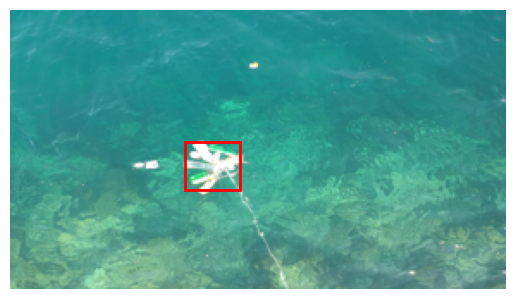

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import json
import matplotlib.patches as patches
from PIL import Image


def get_bounding_boxes(json_path):
  with open(json_path) as f:
      json_data = json.load(f)
  boxes = []
  for shape in json_data["shapes"]:
      xy1, xy2 = shape['points']
      x1, y1 = xy1
      x2, y2 = xy2
      width = x2 - x1
      height = y2 - y1
      boxes.append([x1, y1, width, height])
  return boxes

def plot_bounding_boxes(boxes):
      for box in boxes:
        if len(box) > 4: box = box[:4]
        x1, y1, width, height = box
        rect = patches.Rectangle((x1, y1), width, height, linewidth=2, edgecolor='r', facecolor='none')
        plt.gca().add_patch(rect)

def plot_img(img):
  plt.imshow(img)
  plt.axis('off')  # Turn off axis


img_path = "/content/Trash-detection-/data/Dataset/training/images/train_image1.JPG"
img = Image.open(img_path)
original_width, original_height = img.size
new_width, new_height = 288, 162
img = img.resize((new_width, new_height))
json_path = "/content/Trash-detection-/data/Dataset/training/jsons/train_image1.json"
bounding_boxes = get_bounding_boxes(json_path)
x_scale = new_width / original_width
y_scale = new_height / original_height
# print(tuple(bounding_boxes[0]))
x_min, y_min, x_max, y_max = tuple(bounding_boxes[0])
new_x_min = int(x_min * x_scale)
new_y_min = int(y_min * y_scale)
new_x_max = int(x_max * x_scale)
new_y_max = int(y_max * y_scale)
bounding_boxes = [[new_x_min, new_y_min, new_x_max, new_y_max]]
plot_img(img)
plot_bounding_boxes(bounding_boxes)
plt.show()


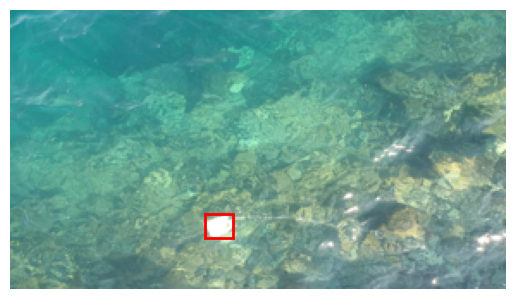

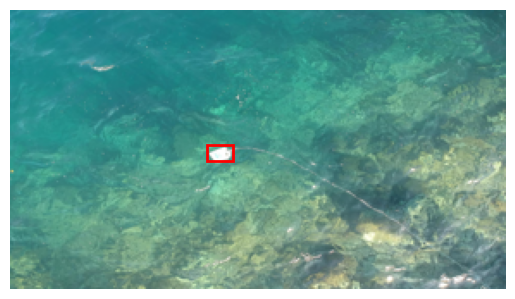

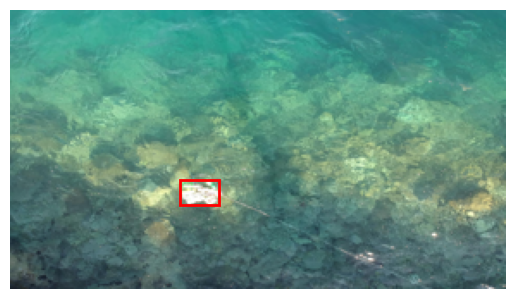

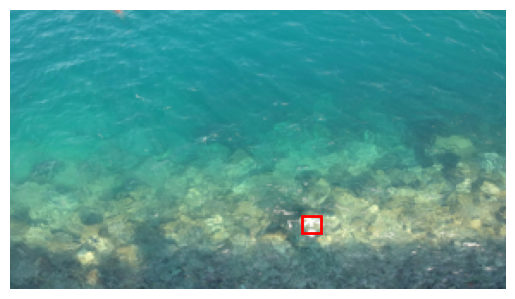

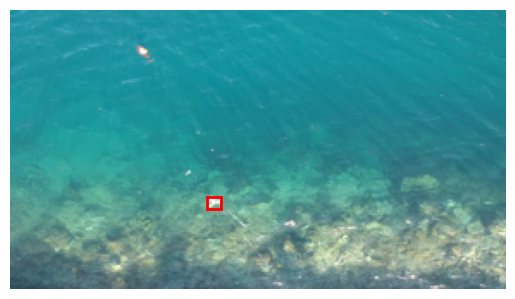

...

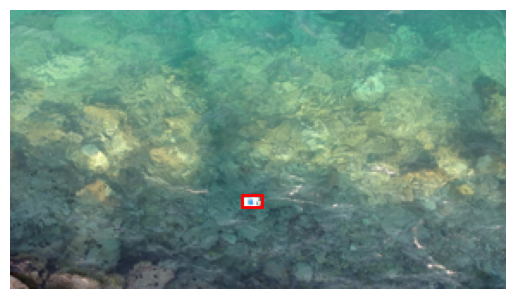

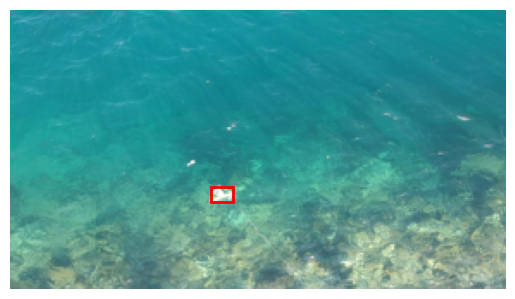

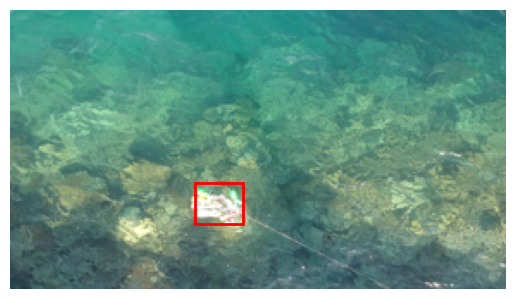

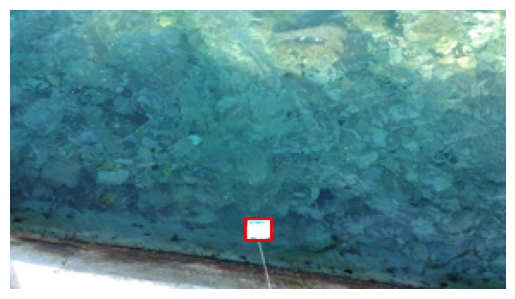

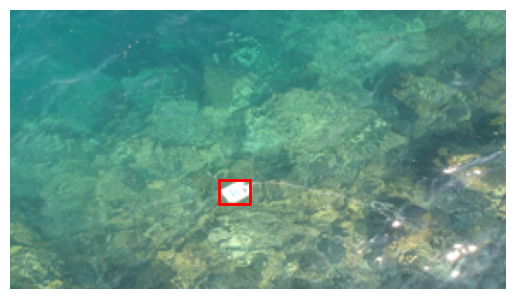

In [ ]:
import os
import glob
from PIL import Image

images = []
directory = '/content/Trash-detection-/data/Dataset/training/images'
jpg_files = glob.glob(os.path.join(directory, '*.JPG'))
for jpg_file in jpg_files:
    json_file = jpg_file[:-3] + 'json'
    json_file = json_file.replace('images', 'jsons')
    img = Image.open(jpg_file)
    original_width, original_height = img.size
    new_width, new_height = 288, 162
    img = img.resize((new_width, new_height))
    bounding_boxes = get_bounding_boxes(json_file)
    x_scale = new_width / original_width
    y_scale = new_height / original_height
    # print(tuple(bounding_boxes[0]))
    x_min, y_min, x_max, y_max = tuple(bounding_boxes[0])
    new_x_min = int(x_min * x_scale)
    new_y_min = int(y_min * y_scale)
    new_x_max = int(x_max * x_scale)
    new_y_max = int(y_max * y_scale)
    bounding_boxes = [[new_x_min, new_y_min, new_x_max, new_y_max]]
    images.append((img, bounding_boxes)) # bounding = (x1, y1, width, height)
    plot_img(img)
    plot_bounding_boxes(bounding_boxes)
    plt.show()



In [ ]:
import albumentations as A
import cv2


In [ ]:
transform = A.Compose([
    A.Rotate(p=1),
    A.RandomBrightnessContrast(brightness_by_max=True, p=1),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
], bbox_params=A.BboxParams(format='coco', min_area=0, min_visibility=0,))


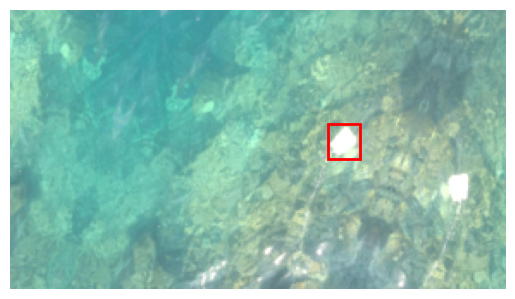

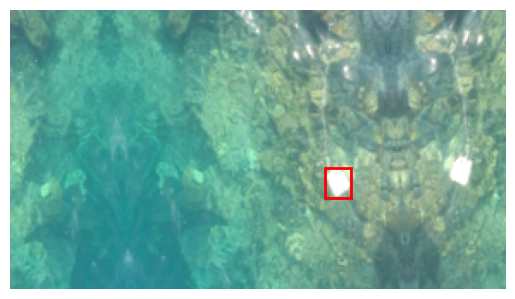

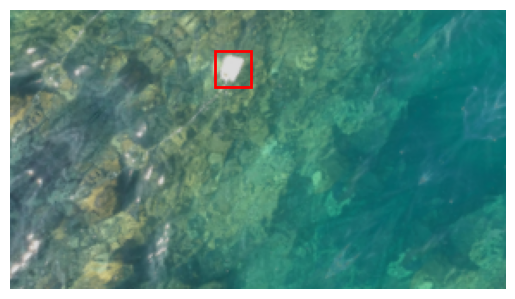

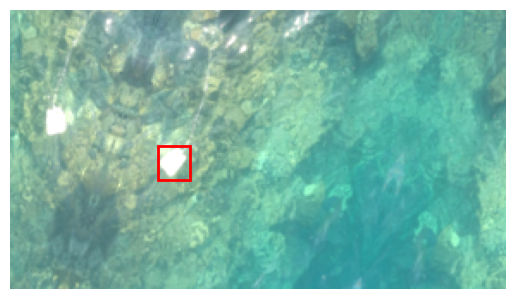

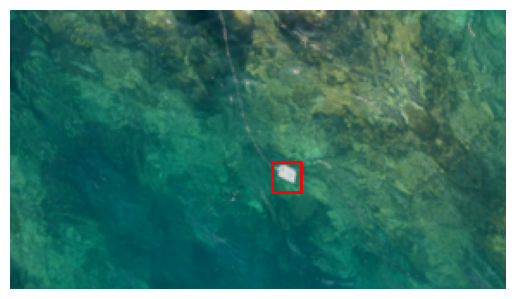

...

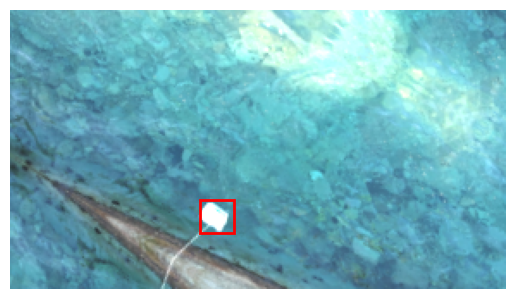

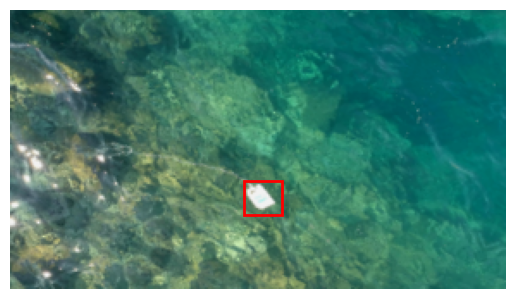

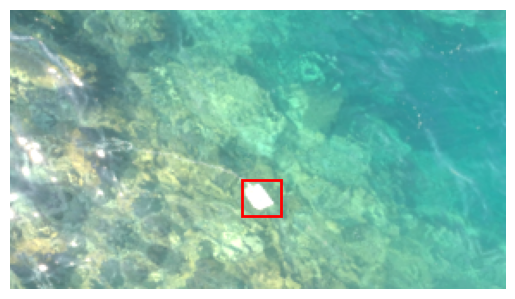

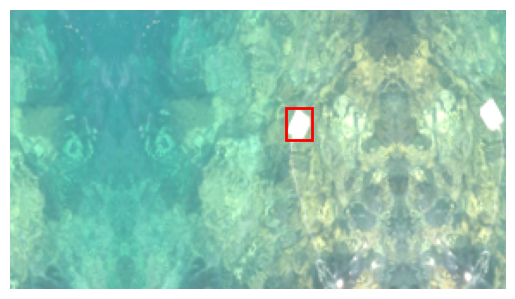

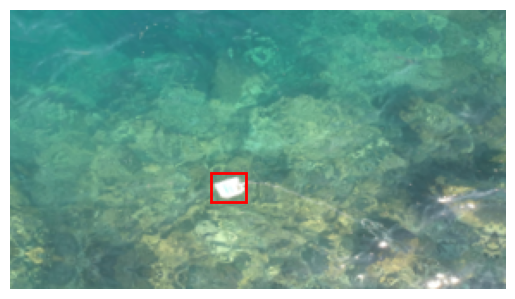

In [ ]:
import cv2

augument_data = []
for image, bboxes in images:
  for box in bboxes:
    box.append('trash')
  for _ in range(4):
    transformed = transform(image=np.array(image), bboxes=bboxes)
    transformed_image = transformed['image']
    transformed_bboxes = transformed['bboxes']
    # print((transformed_image, transformed_bboxes[0][:4]))
    augument_data.append((transformed_image, transformed_bboxes[0][:4]))
    plot_img(transformed_image)
    plot_bounding_boxes(transformed_bboxes)
    plt.show()

# Process non-augmented images
for image, bboxes in images:
    augument_data.append((image, bboxes[0][:4]))



[[99.32037037037037, 22.853703703703705, 28.88888888888887, 47.03703703703703]]


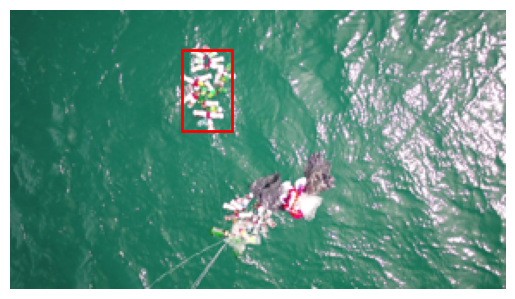

[[109.32037037037036, 32.48333333333333, 28.14814814814814, 45.0]]


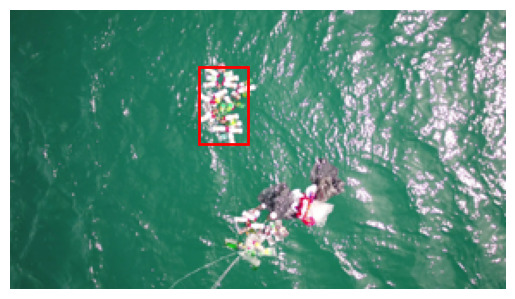

[[216.40449438202248, 31.123595505617978, -5.786516853932596, -14.213483146067416]]


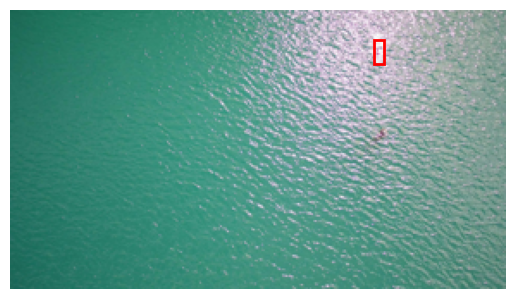

[[132.48502994011974, 79.22155688622753, 8.802395209580851, 9.970059880239523]]


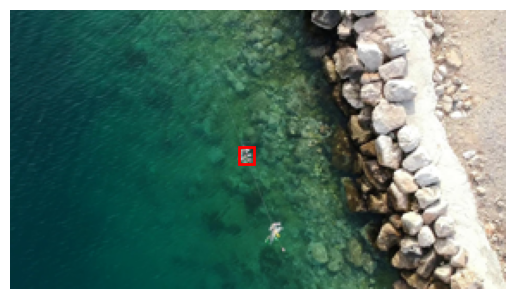

[[133.60655737704917, 36.31147540983606, 8.688524590163933, 9.91803278688525]]


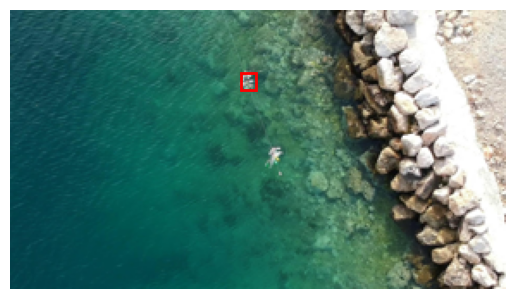

[[145.91259640102828, 40.71979434447301, 5.051413881748067, 4.511568123393311]]
[[162.97297297297297, 73.98648648648648, -24.324324324324312, -14.797297297297296]]
[[161.5979381443299, 66.80412371134021, 24.896907216494842, -49.793814432989684]]
[[119.87592592592591, 41.37222222222221, 21.851851851851848, 37.962962962962955]]
[[75.65573770491802, 89.09836065573771, 23.524590163934427, -10.00000000000001]]
[[175.55921052631578, 32.56578947368421, 15.098684210526311, 14.703947368421055]]
[[87.28333333333332, 13.224074074074071, 12.407407407407407, 11.851851851851853]]
[[169.81481481481478, 135.37037037037035, -17.96296296296295, -6.728395061728383]]
[[141.29213483146066, 16.46067415730337, 10.00000000000001, 8.089887640449437]]
[[166.07784431137725, 38.35329341317365, -12.305389221556903, 16.61676646706587]]
[[93.125, 69.58333333333333, -18.125000000000004, 21.041666666666675]]
[[98.80239520958084, 12.574850299401197, 8.17365269461079, 9.790419161676649]]
[[257.8301886792452, 129.3396226

In [ ]:
test_images = []
directory = '/content/Trash-detection-/data/Dataset/test/images'
jpg_files = glob.glob(os.path.join(directory, '*.JPG'))
i=0
for jpg_file in jpg_files:
    i+=1
    json_file = jpg_file[:-3] + 'json'
    json_file = json_file.replace('images', 'jsons')
    img = Image.open(jpg_file)
    original_width, original_height = img.size
    new_width, new_height = 288, 162
    img = img.resize((new_width, new_height))
    bounding_boxes = get_bounding_boxes(json_file)
    x_scale = new_width / original_width
    y_scale = new_height / original_height
    # print(tuple(bounding_boxes[0]))
    x_min, y_min, x_max, y_max = tuple(bounding_boxes[0])
    new_x_min = x_min * x_scale
    new_y_min = y_min * y_scale
    new_x_max = x_max * x_scale
    new_y_max = y_max * y_scale
    bounding_boxes = [[new_x_min, new_y_min, new_x_max, new_y_max]]
    print(bounding_boxes)
    test_images.append((np.array(image), bounding_boxes)) # bounding = (x1, y1, width, height)
    if i<6:
      plot_img(img)
      plot_bounding_boxes(bounding_boxes)
      plt.show()


[[139.14027149321268, 39.36651583710407, -10.723981900452497, 26.538461538461544]]


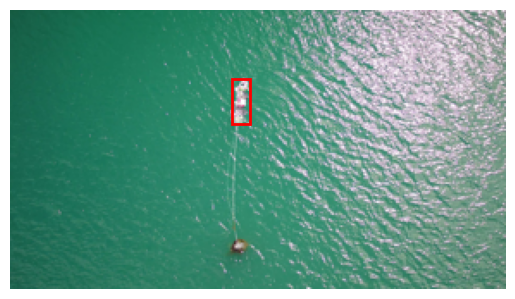

[[204.69074074074072, 84.14999999999998, -12.777777777777782, 16.481481481481485]]


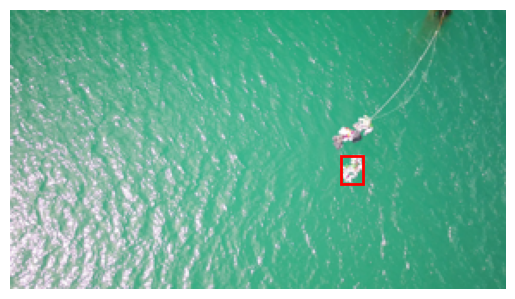

[[131.35740740740738, 55.63148148148147, 28.703703703703695, 30.370370370370367]]


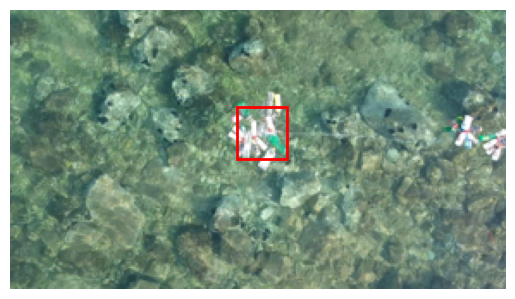

[[148.7648148148148, 125.07592592592592, 53.14814814814815, -57.22222222222223]]


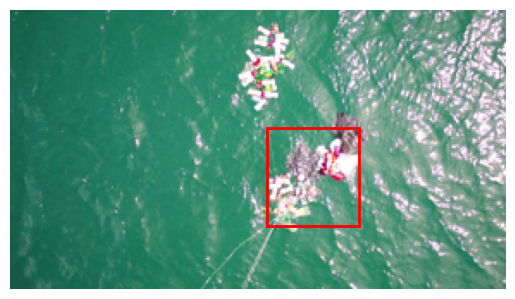

[[181.35740740740738, 54.520370370370365, 21.85185185185188, 63.51851851851851]]


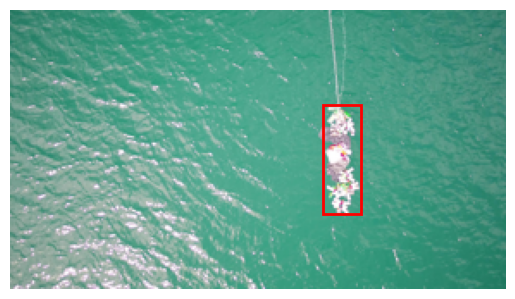

[[52.81437125748503, 82.18562874251498, 9.52095808383234, 10.868263473053888]]
[[61.41732283464567, 96.37795275590551, 12.755905511811022, 16.06299212598425]]
[[179.00552486187846, 69.2817679558011, 15.745856353591137, 5.7182320441988965]]
[[202.60180995475113, 35.97285067873303, 6.6515837104072375, -16.085972850678733]]
[[109.40119760479041, 73.11377245508982, 11.766467065868271, 8.263473053892222]]
[[104.69072164948453, 100.51546391752578, 19.17525773195877, 30.77319587628865]]
[[24.70059880239521, 115.50898203592814, 14.550898203592816, 16.886227544910177]]
[[142.4685185185185, 77.48333333333333, 10.925925925925924, 11.2962962962963]]
[[109.53947368421053, 87.73026315789473, 13.815789473684202, 18.25657894736842]]
[[66.85039370078741, 33.661417322834644, 14.173228346456684, 12.401574803149604]]
[[134.8759259259259, 11.927777777777775, 25.740740740740726, 48.148148148148145]]
[[141.04072398190044, 68.34841628959276, 11.19909502262443, 6.176470588235295]]
[[166.29022465088036, 71.9064

In [ ]:
val_images = []
directory = '/content/Trash-detection-/data/Dataset/validation/images'
jpg_files = glob.glob(os.path.join(directory, '*.JPG'))
i=0
for jpg_file in jpg_files:
    i+=1
    json_file = jpg_file[:-3] + 'json'
    json_file = json_file.replace('images', 'jsons')
    img = Image.open(jpg_file)
    original_width, original_height = img.size
    new_width, new_height = 288, 162
    img = img.resize((new_width, new_height))
    bounding_boxes = get_bounding_boxes(json_file)
    x_scale = new_width / original_width
    y_scale = new_height / original_height
    # print(tuple(bounding_boxes[0]))
    x_min, y_min, x_max, y_max = tuple(bounding_boxes[0])
    new_x_min = x_min * x_scale
    new_y_min = y_min * y_scale
    new_x_max = x_max * x_scale
    new_y_max = y_max * y_scale
    bounding_boxes = [[new_x_min, new_y_min, new_x_max, new_y_max]]
    print(bounding_boxes)
    val_images.append((np.array(image), bounding_boxes)) # bounding = (x1, y1, width, height)
    if i<6:
      plot_img(img)
      plot_bounding_boxes(bounding_boxes)
      plt.show()


In [ ]:
from PIL import Image
import torch
import torchvision
from torchvision.transforms import ToTensor
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt

import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import os
import pickle
import random
import time

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device


device(type='cuda')

In [ ]:
class Dataset():
    def __init__(self, train_images, train_labels, train_boxes):
        self.images = torch.permute(torch.from_numpy(train_images),(0,3,1,2)).float()
        self.labels = torch.from_numpy(train_labels).type(torch.LongTensor)
        self.boxes = torch.from_numpy(train_boxes).float()

    def __len__(self):
        return len(self.labels)

    # To return x,y values in each iteration over dataloader as batches.

    def __getitem__(self, idx):
        return (self.images[idx],
              self.labels[idx],
              self.boxes[idx])

# Inheriting from Dataset class

class ValDataset(Dataset):

    def __init__(self, val_images, val_labels, val_boxes):

        self.images = torch.permute(torch.from_numpy(val_images),(0,3,1,2)).float()
        self.labels = torch.from_numpy(val_labels).type(torch.LongTensor)
        self.boxes = torch.from_numpy(val_boxes).float()

class TestDataset(Dataset):

    def __init__(self, val_images, val_labels, val_boxes):

        self.images = torch.permute(torch.from_numpy(val_images),(0,3,1,2)).float()
        self.labels = torch.from_numpy(val_labels).type(torch.LongTensor)
        self.boxes = torch.from_numpy(val_boxes).float()


In [ ]:
dataset = Dataset(np.array([data[0] for data in augument_data]),
                  np.array([0 for data in augument_data]),
                  np.array([data[1] for data in augument_data]))


In [ ]:
[data[1][0] for data in val_images]

[[139.14027149321268,
  39.36651583710407,
  -10.723981900452497,
  26.538461538461544],
 [204.69074074074072,
  84.14999999999998,
  -12.777777777777782,
  16.481481481481485],
 [131.35740740740738,
  55.63148148148147,
  28.703703703703695,
  30.370370370370367],
 [148.7648148148148,
  125.07592592592592,
  53.14814814814815,
  -57.22222222222223],
 [181.35740740740738,
  54.520370370370365,
  21.85185185185188,
  63.51851851851851],
 [52.81437125748503, 82.18562874251498, 9.52095808383234, 10.868263473053888],
 [61.41732283464567, 96.37795275590551, 12.755905511811022, 16.06299212598425],
 [179.00552486187846,
  69.2817679558011,
  15.745856353591137,
  5.7182320441988965],
 [202.60180995475113,
  35.97285067873303,
  6.6515837104072375,
  -16.085972850678733],
 [109.40119760479041,
  73.11377245508982,
  11.766467065868271,
  8.263473053892222],
 [104.69072164948453,
  100.51546391752578,
  19.17525773195877,
  30.77319587628865],
 [24.70059880239521,
  115.50898203592814,
  14.550

In [ ]:
valdataset = ValDataset(np.array([data[0] for data in val_images]),
                  np.array([0 for data in val_images]),
                  np.array([data[1][0] for data in val_images]))

testdataset = TestDataset(np.array([data[0] for data in test_images]),
                  np.array([0 for data in test_images]),
                  np.array([data[1][0] for data in test_images]))


In [ ]:
train_loader = torch.utils.data.DataLoader(
       dataset, batch_size=4, shuffle=True)

images, classes, targets = next(iter(train_loader))
images.shape

torch.Size([4, 3, 162, 288])

In [ ]:
targets

tensor([[156.0953,  78.9996,  12.2062,  11.5024],
        [139.0493,  84.1649,  15.1700,  15.1700],
        [127.9484,  81.6383,   7.7030,   7.7030],
        [101.4739,  73.7134,  36.7665,  30.9891]])

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class SimpleCNN(nn.Module):
    def __init__(self):
        super(SimpleCNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 16, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(16, 32, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        # Define the fully connected layers for bounding box prediction
        self.fc1 = nn.Linear(64 * 20 * 36, 128)
        self.fc2 = nn.Linear(128, 4)  # 4 values for bounding box coordinates (x, y, w, h)


    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))

        x = x.view(x.size(0), -1)  # Flatten the tensor

        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x



In [ ]:
from torchsummary import summary
model = SimpleCNN()

summary(model, (3,162,288))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 162, 288]             448
         MaxPool2d-2          [-1, 16, 81, 144]               0
            Conv2d-3          [-1, 32, 81, 144]           4,640
         MaxPool2d-4           [-1, 32, 40, 72]               0
            Conv2d-5           [-1, 64, 40, 72]          18,496
         MaxPool2d-6           [-1, 64, 20, 36]               0
            Linear-7                  [-1, 128]       5,898,368
            Linear-8                    [-1, 4]             516
Total params: 5,922,468
Trainable params: 5,922,468
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.53
Forward/backward pass size (MB): 12.43
Params size (MB): 22.59
Estimated Total Size (MB): 35.56
----------------------------------------------------------------


In [ ]:
# Tworzenie instancji modelu
model = SimpleCNN()
output = model(images)
print(output.shape)


torch.Size([4, 4])


In [ ]:
valdataloader = torch.utils.data.DataLoader(
       valdataset, batch_size=4, shuffle=True)

images, classes, targets = next(iter(valdataloader))
targets

tensor([[ 66.8504,  33.6614,  14.1732,  12.4016],
        [109.5395,  87.7303,  13.8158,  18.2566],
        [202.6018,  35.9729,   6.6516, -16.0860],
        [136.5000,  33.7500, -17.4000,  39.6000]])

In [ ]:
# Tworzenie instancji modelu
model = SimpleCNN()
output = model(images)
print(output.shape)


torch.Size([4, 4])


In [ ]:
output

tensor([[-4.3829, -0.1713,  1.6443, -0.6305],
        [-4.3829, -0.1713,  1.6443, -0.6305],
        [-4.3829, -0.1713,  1.6443, -0.6305],
        [-4.3829, -0.1713,  1.6443, -0.6305]], grad_fn=<AddmmBackward0>)

In [ ]:
def get_num_correct(preds, labels):
    # Get the predicted class by taking the index with the highest score
    _, predicted_labels = torch.max(preds, 1)
    # Compare with the true labels and count the number of correct predictions
    correct = (predicted_labels == labels).sum().item()
    return correct

In [ ]:
def train(model, train_loader, val_loader):
    # Defining the optimizer
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    num_of_epochs = 1
    train_losses = []
    test_losses = []

    for epoch in range(num_of_epochs):
        model.train()
        train_loss = 0
        train_start = time.time()

        for batch, (x, y, z) in enumerate(train_loader):
            # Converting data from CPU to GPU if available to improve speed
            x, y, z = x.to(device), y.to(device), z.to(device)
            # Sets the gradients of all optimized tensors to zero
            optimizer.zero_grad()
            z_pred = model(x)
            # Compute loss (MSELoss for bounding box regression)
            box_loss = F.mse_loss(z_pred, z)
            box_loss.backward()
            optimizer.step()
            train_loss += box_loss.item()

            print(f"Train batch: {batch+1}, box_loss: {box_loss.item():.4f}, epoch: {epoch}, time: {(time.time()-train_start)/60:.2f} mins")

            # Sample the losses at specific intervals (e.g., 10 points)
            if batch % (len(train_loader) // 10) == 0:
                train_losses.append(train_loss / (batch + 1))

                model.eval()
                val_loss = 0
                with torch.no_grad():
                    for batch, (x, y, z) in enumerate(val_loader):
                        # Converting data from CPU to GPU if available to improve speed
                        x, y, z = x.to(device), y.to(device), z.to(device)
                        z_pred = model(x)
                        box_loss = F.mse_loss(z_pred, z)
                        val_loss += box_loss.item()

                test_losses.append(val_loss / len(val_loader))
                print(f"Epoch {epoch}, Train Loss: {train_loss / len(train_loader):.4f}, Validation Loss: {val_loss / len(val_loader):.4f}, Time: {(time.time()-train_start)/60:.2f} mins")

    return train_losses, test_losses


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = SimpleCNN()
model.to(device)
train_losses, test_losses = train(model, train_loader, valdataloader)


Train batch: 1, box_loss: 5973.3022, epoch: 0, time: 0.00 mins
Epoch 0, Train Loss: 238.9321, Validation Loss: 3435.4712, Time: 0.00 mins
Train batch: 2, box_loss: 2894.0537, epoch: 0, time: 0.00 mins
Train batch: 3, box_loss: 4058.7847, epoch: 0, time: 0.00 mins
Epoch 0, Train Loss: 517.0456, Validation Loss: 1890.1444, Time: 0.00 mins
Train batch: 4, box_loss: 1979.3427, epoch: 0, time: 0.00 mins
Train batch: 5, box_loss: 448.4248, epoch: 0, time: 0.00 mins
Epoch 0, Train Loss: 614.1563, Validation Loss: 1145.1353, Time: 0.00 mins
Train batch: 6, box_loss: 829.0060, epoch: 0, time: 0.00 mins
Train batch: 7, box_loss: 607.1772, epoch: 0, time: 0.00 mins
Epoch 0, Train Loss: 671.6037, Validation Loss: 1135.8692, Time: 0.00 mins
Train batch: 8, box_loss: 1543.4937, epoch: 0, time: 0.00 mins
Train batch: 9, box_loss: 1104.9106, epoch: 0, time: 0.00 mins
Epoch 0, Train Loss: 777.5398, Validation Loss: 1590.3347, Time: 0.00 mins
Train batch: 10, box_loss: 1373.6282, epoch: 0, time: 0.00 mi

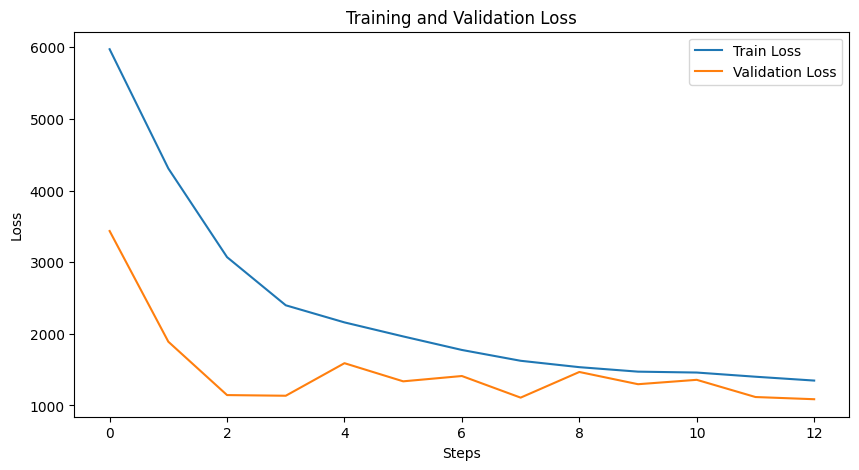

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Train Loss')
plt.plot(test_losses, label='Validation Loss')
plt.xlabel('Steps')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()


In [ ]:
from collections import namedtuple
from typing import List, Tuple

Rectangle = namedtuple("Rectangle", ["x_l", "y_b", "x_r", "y_t"])

def iou_rectangles(rect1: Rectangle, rect2: Rectangle):
    x_left = max(rect1.x_l, rect2.x_l)
    x_right = min(rect1.x_r, rect2.x_r)
    y_bottom = max(rect1.y_b, rect2.y_b)
    y_top = min(rect1.y_t, rect2.y_t)

    intersection = max(0, x_right - x_left) * max(0, y_top - y_bottom)

    area1 = (rect1.x_r - rect1.x_l) * (rect1.y_t - rect1.y_b)
    area2 = (rect2.x_r - rect2.x_l) * (rect2.y_t - rect2.y_b)

    union = area1 + area2 - intersection
    return intersection / union


def calculate_ap50(true_rectangles, predicted_rectangles, predicted_confidences=None, iou_threshold=0.5):
    """
    Calculate the precision for a given IoU threshold. Rectangles should be from the same class.
    @param true_rectangles: List of true rectangles
    @param predicted_rectangles: List of predicted rectangles
    @param predicted_confidences: List of predicted confidences
    @param iou_threshold: IoU threshold
    """

    # Sort predicted rectangles by confidence score
    if predicted_confidences is not None:
        sorted_indices = np.argsort(predicted_confidences)[::-1]
        predicted_rectangles = [predicted_rectangles[i] for i in sorted_indices]

    tp = 0
    fp = 0

    for pred_rect in predicted_rectangles:
        is_tp = False
        for true_rect in true_rectangles:
            iou = iou_rectangles(pred_rect, true_rect)
            if iou >= iou_threshold:
                is_tp = True
                break
        if is_tp:
            tp += 1
        else:
            fp += 1

    precision = tp / (tp + fp) if tp + fp > 0 else None

    return precision, tp, fp


def draw_rectangles(image, rectangles: List[Rectangle], color=(0, 255, 0)):
    for rectangle in rectangles:
        cv2.rectangle(image, (rectangle.x_l, rectangle.y_b), (rectangle.x_r, rectangle.y_t), color, 3)
    return image

model.eval()
pred_boxes, true_boxes =[], []
with torch.no_grad():
    for batch, (x, y, z) in enumerate(valdataloader):
        # Converting data from CPU to GPU if available to improve speed
        x, y, z = x.to(device), y.to(device), z.to(device)
        z_pred = model(x)
        for x_l, y_b, x_r, y_t in z_pred.tolist():
          pred_boxes.append(Rectangle(x_l, y_b, x_r, y_t))
        for x_l, y_b, x_r, y_t in z.tolist():
          true_boxes.append(Rectangle(x_l, y_b, x_r, y_t))

calculate_ap50(pred_boxes, true_boxes)


(0.0, 0, 20)

In [ ]:
testdataloader = torch.utils.data.DataLoader(
       testdataset, batch_size=4, shuffle=True)

images, classes, targets = next(iter(testdataloader))
targets

tensor([[114.3750, 140.1316,  15.0987,  20.6250],
        [143.3944, 101.9278,  33.3333, -35.3704],
        [132.4850,  79.2216,   8.8024,   9.9701],
        [109.2520,  58.9370,  60.5905, -23.5039]])

In [ ]:
model.eval()
pred_boxes, true_boxes =[], []
with torch.no_grad():
    for batch, (x, y, z) in enumerate(testdataloader):
        # Converting data from CPU to GPU if available to improve speed
        x, y, z = x.to(device), y.to(device), z.to(device)
        z_pred = model(x)
        for x_l, y_b, x_r, y_t in z_pred.tolist():
          pred_boxes.append(Rectangle(x_l, y_b, x_r, y_t))
        for x_l, y_b, x_r, y_t in z.tolist():
          true_boxes.append(Rectangle(x_l, y_b, x_r, y_t))

calculate_ap50(pred_boxes, true_boxes)


(0.0, 0, 122)

In [ ]:
model.eval()
pred_boxes, true_boxes =[], []
with torch.no_grad():
    for batch, (x, y, z) in enumerate(train_loader):
        # Converting data from CPU to GPU if available to improve speed
        x, y, z = x.to(device), y.to(device), z.to(device)
        z_pred = model(x)
        for x_l, y_b, x_r, y_t in z_pred.tolist():
          pred_boxes.append(Rectangle(x_l, y_b, x_r, y_t))
        for x_l, y_b, x_r, y_t in z.tolist():
          true_boxes.append(Rectangle(x_l, y_b, x_r, y_t))

calculate_ap50(pred_boxes, true_boxes)


(0.0, 0, 100)

# YOLO

In [ ]:
augument_data[0][1]

In [ ]:
!mkdir /content/Trash-detection-/data/augument_yolo_format/images
!mkdir /content/Trash-detection-/data/augument_yolo_format/labels

In [ ]:
!touch classes.txt
!echo "trash" > classes.txt
!mv classes.txt /content/Trash-detection-/data/augument_yolo_format

In [ ]:
def convert_to_yolo_format(bbox, img_width, img_height):
    x1, y1, width, height, _ = bbox
    # Normalize coordinates
    x_center = (x1 + width / 2) / img_width
    y_center = (y1 + height / 2) / img_height
    norm_width = width / img_width
    norm_height = height / img_height
    # Format YOLO output
    yolo_output = f"0 {x_center} {y_center} {norm_width} {norm_height}"
    # print(yolo_output)
    return yolo_output

path_img = "/content/Trash-detection-/data/augument_yolo_format/images"
path_labels = "/content/Trash-detection-/data/augument_yolo_format/labels"

for i, augum in enumerate(augument_data):
  img, bounding_boxes = augum[0], augum[1]
  converted_image = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
  cv2.imwrite(f'{path_img}/{i}.jpg', converted_image)

  img_width, img_height, _ = img.shape
  yolo_txt = convert_to_yolo_format(bounding_boxes[0], img_width, img_height)
  with open(f"{path_labels}/{i}.txt", "w") as file:
    file.write(yolo_txt)




In [ ]:
yolo_ds = "/content/Trash-detection-/data/augument_yolo_format"

In [ ]:
!pip install -U ultralytics